In [1]:
from _eth_datas import DataProcessing
from _eth_process import EthernetProcess
from _eth_models import ModelsTraining
from _eth_model_evaluation import ModelEvaluation
from _eth_libs import *

/home/rsb6/Desktop/LIVE/ATV4/ethernet-analyser/ethernet-env/lib/python3.12/site-packages/pydub/utils.py:170: RuntimeWarning: Couldn't find ffmpeg or avconv - defaulting to ffmpeg, but may not work
  warn("Couldn't find ffmpeg or avconv - defaulting to ffmpeg, but may not work", RuntimeWarning)
2024-07-03 20:52:02.381443: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:479] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-07-03 20:52:02.403987: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:10575] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-07-03 20:52:02.404016: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1442] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-07-03 20:52:02.418911: I tensorflow/core/platform/cpu_feature_gu

In [2]:
eth = EthernetProcess()
dtx = DataProcessing()
md  = ModelsTraining()
ev  = ModelEvaluation()


In [3]:
PATH = '/home/rsb6/Desktop/LIVE/ATV4/ethernet-analyser/'

# path for datas
path = PATH + 'src/Dataset_labeled'
# path = PATH + 'src/Dataset_labeled/labeled_delay.csv'


datas, data_numeric, target = dtx.dataset_transform(path, selected_features=['chanel0', 'chanel1', 'time_diff'], all_dataframe=True)


In [4]:
dtx.plot_class_distribution(datas)

## **Algorithm training**

In [5]:
# Usar apenas se o treino for feito para labels [0, 1]
datas, target = dtx.encode_dataframe(datas, target, classify_to_binary=True)

In [6]:
target

array([0, 0, 0, ..., 1, 1, 0])

In [7]:
x_train, x_test, y_train, y_test = train_test_split(data_numeric, target, test_size = 0.3, random_state = 0)

In [14]:
md.random_forest_train(x_train, x_test, y_train, y_test)

              precision    recall  f1-score   support

           0       1.00      1.00      1.00    512851
           1       1.00      1.00      1.00     52368

    accuracy                           1.00    565219
   macro avg       1.00      1.00      1.00    565219
weighted avg       1.00      1.00      1.00    565219



In [9]:
md.naive_byes_train(x_train, x_test, y_train, y_test)

/home/rsb6/Desktop/LIVE/ATV4/ethernet-analyser/ethernet-env/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/home/rsb6/Desktop/LIVE/ATV4/ethernet-analyser/ethernet-env/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

           0       0.91      1.00      0.95    512851
           1       0.00      0.00      0.00     52368

    accuracy                           0.91    565219
   macro avg       0.45      0.50      0.48    565219
weighted avg       0.82      0.91      0.86    565219



/home/rsb6/Desktop/LIVE/ATV4/ethernet-analyser/ethernet-env/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



In [10]:
md.gradient_boost_train(x_train, x_test, y_train, y_test)

              precision    recall  f1-score   support

           0       1.00      1.00      1.00    512851
           1       1.00      1.00      1.00     52368

    accuracy                           1.00    565219
   macro avg       1.00      1.00      1.00    565219
weighted avg       1.00      1.00      1.00    565219



In [11]:
md.mlp_train(x_train, y_train, mult_label=True)


/home/rsb6/Desktop/LIVE/ATV4/ethernet-analyser/ethernet-env/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.

2024-07-03 20:58:40.701684: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:998] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-07-03 20:58:40.762564: W tensorflow/core/common_runtime/gpu/gpu_device.cc:2251] Cannot dlopen some GPU libraries. Please make sure the missing libraries mentioned above are installed properly if you would like to use GPU. Follow the guide at https://www.tensorflow.org/install/gpu for how to download and setup the required libraries for your platfor

Epoch 1/100


ValueError: Arguments `target` and `output` must have the same rank (ndim). Received: target.shape=(None,), output.shape=(None, 5)

## **Load weights trained**

In [12]:
naive_path = PATH + 'tests/trained_models/models_multclass/naive_model.pkl'
mlp_path = PATH + 'tests/trained_models/models_monoclass/mlp_model.weights.h5'
random_path = PATH + 'src/scripts/forest_model.pkl'
boosting_path = PATH + 'tests/trained_models/models_multclass/boost_model.pkl'


imput_dim = x_test.shape[1]
# Carregar modelos treinados
naive = ev.load_trained_model(naive_path, imput_dim)
# mlp = ev.load_trained_model(mlp_path, imput_dim, model_name='mlp')
random = ev.load_trained_model(random_path, imput_dim)
boosting = ev.load_trained_model(boosting_path, imput_dim)


#### **MPL**

17664/17664 ━━━━━━━━━━━━━━━━━━━━ 22s 1ms/step - accuracy: 0.9127 - loss: 0.2957
17664/17664 ━━━━━━━━━━━━━━━━━━━━ 23s 1ms/step


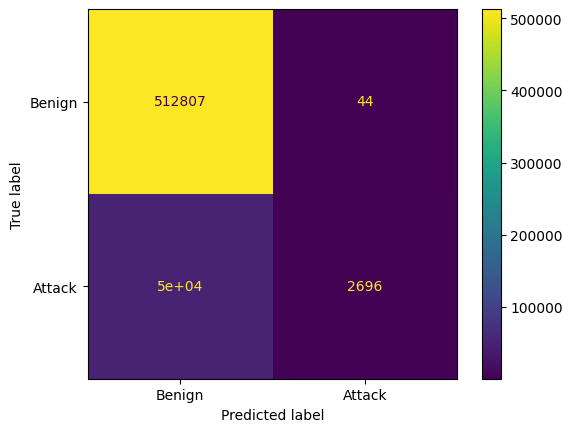

In [ ]:
# MLP model
loss, accuracy = model.evaluate(x_test, y_test)
# Plot Confuse Mattrix
ev.plot_confusion_matrix(mlp, x_test, y_test)

#### **NAIVE BYES**

*****************************************************
Acurácia no conjunto de treino: 0.892859038459497
*****************************************************

*****************************************************
Acurácia no conjunto de teste: 0.8922576912665711
*****************************************************

Relatório de classificação - Conjunto de Treino:
*****************************************************
-----------------------------------------------------
              precision    recall  f1-score   support

           0       0.91      0.98      0.94   1197262
           1       0.24      0.08      0.12    121580

    accuracy                           0.89   1318842
   macro avg       0.58      0.53      0.53   1318842
weighted avg       0.85      0.89      0.87   1318842


-----------------------------------------------------
*****************************************************
Relatório de classificação - Conjunto de Teste:
              precision    recall  f1-sco

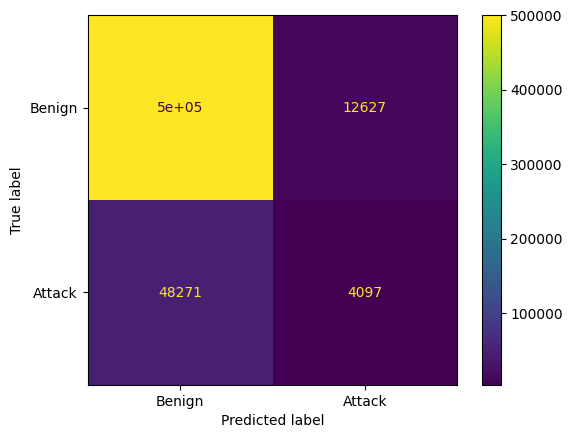

In [ ]:
ev.evaluate_overfitting_and_plot_roc(naive_path ,x_train, y_train, x_test, y_test)

### **RANDON FORESTE**

*****************************************************
Acurácia no conjunto de treino: 0.9999984835181166
*****************************************************

*****************************************************
Acurácia no conjunto de teste: 0.9999628462595914
*****************************************************

Relatório de classificação - Conjunto de Treino:
*****************************************************
-----------------------------------------------------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00   1197262
           1       1.00      1.00      1.00    121580

    accuracy                           1.00   1318842
   macro avg       1.00      1.00      1.00   1318842
weighted avg       1.00      1.00      1.00   1318842


-----------------------------------------------------
*****************************************************
Relatório de classificação - Conjunto de Teste:
              precision    recall  f1-sc

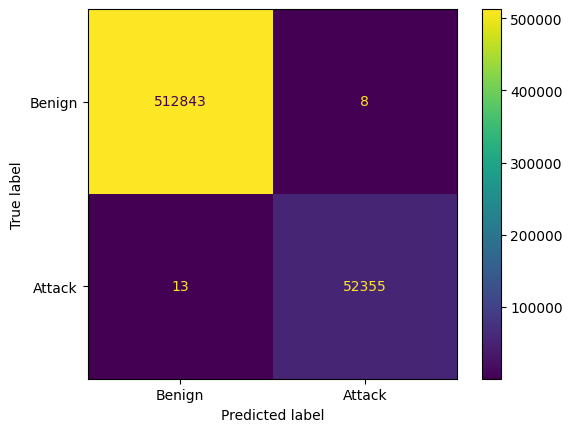

In [13]:
ev.evaluate_overfitting_and_plot_roc(random_path ,x_train, y_train, x_test, y_test)


### **GRADIENT BOOSTING**

*****************************************************
Acurácia no conjunto de treino: 0.9123518965880674
*****************************************************

*****************************************************
Acurácia no conjunto de teste: 0.9120411734212757
*****************************************************

Relatório de classificação - Conjunto de Treino:
*****************************************************
-----------------------------------------------------
              precision    recall  f1-score   support

           0       0.91      1.00      0.95   1197262
           1       0.98      0.05      0.10    121580

    accuracy                           0.91   1318842
   macro avg       0.95      0.52      0.52   1318842
weighted avg       0.92      0.91      0.87   1318842


-----------------------------------------------------
*****************************************************
Relatório de classificação - Conjunto de Teste:
              precision    recall  f1-sc

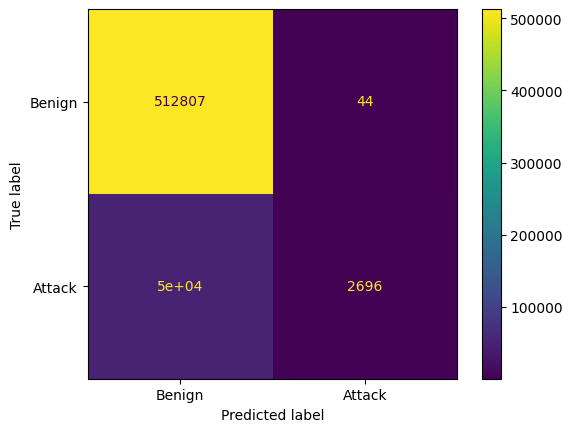

In [ ]:
ev.evaluate_overfitting_and_plot_roc(boosting_path ,x_train, y_train, x_test, y_test)
